# Машинное обучение, ФКН ВШЭ

# Практическое задание 10. Обучение без учителя.

## Общая информация
Дата выдачи: 13.03.2021

Мягкий дедлайн: 28.03.2021 01:59 MSK

Жёсткий дедлайн: 01.04.2021 01:59 MSK

## Оценивание и штрафы

Каждая из задач имеет определенную «стоимость» (указана в скобках около задачи). Максимально допустимая оценка за работу — 10 баллов.

Сдавать задание после указанного срока сдачи нельзя. При выставлении неполного балла за задание в связи с наличием ошибок на усмотрение проверяющего предусмотрена возможность исправить работу на указанных в ответном письме условиях.

Задание выполняется самостоятельно. «Похожие» решения считаются плагиатом и все задействованные студенты (в том числе те, у кого списали) не могут получить за него больше 0 баллов (подробнее о плагиате см. на странице курса). Если вы нашли решение какого-то из заданий (или его часть) в открытом источнике, необходимо указать ссылку на этот источник в отдельном блоке в конце вашей работы (скорее всего вы будете не единственным, кто это нашел, поэтому чтобы исключить подозрение в плагиате, необходима ссылка на источник).

Неэффективная реализация кода может негативно отразиться на оценке.

## Формат сдачи
Задания сдаются через систему anytask. Посылка должна содержать:
* Ноутбук homework-practice-10-Username.ipynb

Username — ваша фамилия на латинице

## О задании

В этом задании мы посмотрим на несколько алгоритмов кластеризации и применим их к географическим и текстовым данным. Также мы подробно остановимся на тематическом моделировании текстов, задаче обучения представлений и в каком-то смысле поработаем с semi-supervised learning. 



In [41]:
import pandas as pd
import numpy as np

np.random.seed(0xFFFFFFF)

**Задание 0 (1e-100 балла)**. Опишите свои ощущения от домашки по ЕМ-алгоритму (можно картинкой или мемом).

Мой друг перегорел и чуть не умер, пока делал эту домашку, поэтому я решил ее не делать :)

## Часть 1. Кластеризация автобусных остановок

В этом задании мы сравним разные алгоритмы кластеризации для данных об автобусных остановках Москвы.

**Задание 1.1 (1 балл).** Реализуйте алгоритм спектральной кластеризации, который упоминался на лекции. Для этого разберитесь с кодом шаблона, данного ниже, и допишите недостающую функцию. Напомним, что для графа с матрицей смежности $W = \{w_{ij}\}_{i, j = 1 \dots \ell}$ лапласиан определяется как:

$$
L = D - W,
$$

где $D = \text{diag}(d_1, ..., d_{\ell}), d_i = \sum_{j=1}^{\ell} w_{ij}$.

In [42]:
from sklearn.base import ClusterMixin
from sklearn.cluster import KMeans


class GraphClustering(ClusterMixin):
    def __init__(self, n_clusters=8, n_components=None, **kwargs):
        '''
        Spectral clustering algorithm
        param n_clusters: number of clusters to form
        param n_components: number of eigenvectors to use
        '''

        if n_components is None:
            n_components = n_clusters

        self.n_components = n_components
        self.kmeans = KMeans(n_clusters=n_clusters, **kwargs)

    def fit_predict(self, X, y=None):
        '''
        Perform spectral clustering from graph adjacency matrix
        and return vertex labels.
        param X: (n_samples, n_samples) - graph adjacency matrix
        return: (n_samples, ) - vertex labels
        '''

        eigenvectors = self._generate_eigenvectors(X)
        labels = self.kmeans.fit_predict(eigenvectors[:, 0:])
        return labels

    def _generate_eigenvectors(self, X):
        '''
        Compute eigenvectors for spectral clustering
        param X: (n_samples, n_samples) - graph adjacency matrix
        return: (n_samples, n_components) - eigenvectors
        '''
        D = np.diag(np.sum(X, 1))
        L = D - X
        w, v = np.linalg.eig(L)
        w = pd.DataFrame(np.real(w))
        eig = v[:, w.sort_values(by=0).index[:self.n_components]]
        eig = np.real(eig)
        n_egs = np.apply_along_axis(np.linalg.norm, 0, eig)
        eig = eig / np.tile(eig.shape[0], 1)
        return eig

Перед тем, как переходить к следующему заданию, протестируйте свое решение.

In [43]:
n_blocks, n_vertices = 10, 1000
block_vertices = n_vertices // n_blocks

X = np.zeros((n_vertices, n_vertices))
for i in range(0, n_vertices, block_vertices):
    X[i:i + block_vertices, i:i + block_vertices] = np.sqrt(i + 1)

graph_clustering = GraphClustering(n_clusters=n_blocks)
labels = graph_clustering.fit_predict(X)

true_labels = np.zeros(n_vertices, dtype=np.int32)
for i in range(0, n_vertices, block_vertices):
    true_labels[i:i + block_vertices] = labels[i]

assert labels.shape == (n_vertices, )
assert np.all(np.bincount(labels) == np.full(n_blocks, block_vertices))
assert np.all(labels == true_labels)

Теперь можем приступить к работе с реальными данными. Скачайте файл с данными об остановках общественного транспорта **в формате .xlsx** по [ссылке](https://data.mos.ru/opendata/download/60464/1/201) (так гарантированно не возникнет проблем с парсингом файла) и загрузите таблицу в ноутбук. Если вдруг сайт Правительства Москвы сойдет с ума, то возьмите какую-нибудь версию данных [отсюда](https://data.mos.ru/opendata/7704786030-city-surface-public-transport-stops). Для удобства визуализации мы будем работать только с остановками в ЦАО.

In [44]:
data = pd.read_excel('transport.xlsx')
data = data[data.AdmArea_en == "Czentral`ny'j administrativny'j okrug"]
data = data.reset_index()
data.head()

,index,ID_en,Name_en,Longitude_WGS84_en,Latitude_WGS84_en,Street_en,AdmArea_en,District_en,RouteNumbers_en,StationName_en,Direction_en,Pavilion_en,OperatingOrgName_en,EntryState_en,global_id,geoData
0,278,347,"«2-й Лесной пер.», улица Бутырский Вал (347)",37.586584,55.782106,улица Бутырский Вал,Czentral`ny'j administrativny'j okrug,Tverskoj rajon,АТ18; А12; АТ56; АТ78,2-й Лесной пер.,NaN,да,ГУП «Мосгортранс»,active,889085436,NaN
1,279,349,"«Ул. Сущевский Вал», Новослободская улица (349)",37.590714,55.790630,Новослободская улица,Czentral`ny'j administrativny'j okrug,Tverskoj rajon,АТ47; АМ10; АТ3; АТ56; АТ78,Ул. Сущевский Вал,NaN,да,ГУП «Мосгортранс»,active,889085437,NaN
2,355,479,"«Стадион Лужники (южн.) (пос.)», улица Лужники...",37.565972,55.714265,улица Лужники,Czentral`ny'j administrativny'j okrug,rajon Xamovniki,А64; А216; А809; АС12; А255; АБК; АТ79,Стадион Лужники (южн.) (пос.),NaN,да,ГУП «Мосгортранс»,active,889085549,NaN
3,356,480,"«Спортзал Дружба», Лужнецкая набережная (480)",37.570191,55.712504,Лужнецкая набережная,Czentral`ny'j administrativny'j okrug,rajon Xamovniki,А64; А216; А809; АС12; А255; АБК; АТ79,Спортзал Дружба,NaN,да,ГУП «Мосгортранс»,active,889085550,NaN
4,357,481,"«Лужнецкая наб.», Лужнецкая набережная (481)",37.574559,55.713770,Лужнецкая набережная,Czentral`ny'j administrativny'j okrug,rajon Xamovniki,А64; А216; А809; АС12; А255; АБК; АТ79,Лужнецкая наб.,NaN,да,ГУП «Мосгортранс»,active,889085551,NaN


Воспользуемся библиотекой `folium` для визуализации данных.

In [45]:
import folium

map = folium.Map([55.75215, 37.61819], zoom_start=12)
for id, row in data.iterrows():
    folium.Circle([row.Latitude_WGS84_en, row.Longitude_WGS84_en],
                  radius=10).add_to(map)
map

**Задание 1.2 (1 балл).** Попробуем построить граф, в котором вершинами будут остановки. Как вы уже могли заметить, для каждой остановки указаны номера маршрутов, проходящих через неё. Логично соединить ребрами соседние остановки каждого маршрута. Однако мы не знаем, в каком порядке автобусы объезжают остановки. Но мы можем применить эвристический алгоритм, который восстановит нам порядок маршрутов:

* Для каждого маршрута выделим список всех остановок, через которые он проходит.
* Выберем начальную остановку маршрута как точку, наиболее удаленную от всех остальных остановок этого маршрута.
* Каждую следующую точку маршрута будем выбирать как самую близкую из оставшихся точек (не включенных в маршрут ранее).

Фактически, у нас получается жадное решение задачи коммивояжера. Когда мы отсортировали маршруты, можем построить по ним граф. Будем строить его по таким правилам:

* Между двумя остановками будет ребро, если они являются соседними хотя бы на одном маршруте. Вес ребра равен числу маршрутов, на которых остановки являются соседними.
* В графе не будет петель (то есть у матрицы смежности будет нулевая диагональ).

Реализуйте предложенный способ построения графа. Для этого рекомендуется воспользоваться шаблонами, приведенными ниже.

In [46]:
def get_routes(data):
    '''
    Accumulate routes from raw data
    param data: pd.DataFrame - public transport stops data
    return: dict - unsorted stops ids for each route,
                   e.g. Так
    '''
    Routes = data['RouteNumbers_en'].apply(lambda x : set(x.replace(" ", "").split(';')))
    Routes.index = data.index
    d_R = dict.fromkeys(set.union(*Routes.values))
    for index, row in Routes.iteritems():
        for el in row:
            if d_R[el] is None:
                d_R[el] = list()        
            d_R[el].append(index)
    return d_R

def sort_routes(data, routes):
    
    '''
    Sort routes according to the proposed algorithm
    param data: pd.DataFrame - public transport stops data
    param routes: dict - unsorted stops ids for each route
    return: dict - sorted stops ids for each route
    '''
    d_R = routes
    m_R = dict.fromkeys(d_R.keys())
    for key in d_R:
        n = len(d_R[key])
        tmp = pd.DataFrame(columns=d_R[key], index=d_R[key])
        mask = np.array([False] * data.shape[0])
        for val in d_R[key]:
            mask[val] = 1
        
        for val in d_R[key]:
            x = data.loc[val, 'Longitude_WGS84_en'] - data[mask]['Longitude_WGS84_en']
            y = data.loc[val, 'Latitude_WGS84_en'] - data[mask]['Latitude_WGS84_en']
            tmp[val] = np.sqrt(x ** 2 + y ** 2).values
        
        tmp['sum'] = tmp.sum(axis=0)
        m = (tmp['sum']).idxmin()
        p = [m]
        l = set(tmp.index) - set(p)
        for i in range(len(d_R[key]) - 1):
            s = (tmp.loc[list(l), m]).idxmin()
            p.append(s)
            m = s
            l -= set([m])
#         print(p)
        m_R[key] = p
    return m_R

def get_adjacency_matrix(data, sorted_routes):
    '''
    Compute adjacency matrix for sorted routes
    param data: pd.DataFrame - public transport stops data
    param sorted_routes: dict - sorted stops ids for each route
    return: (n_samples, n_samples) - graph adjacency matrix
    '''
    m_R = sorted_routes
    mat = np.zeros((data.shape[0], data.shape[0]))
    for key in m_R:
        for i in range(len(m_R[key])):
            for j in range(i, len(m_R[key])):
                mat[m_R[key][i], m_R[key][j]] = 1
    return mat

        

In [47]:
routes = get_routes(data)
sorted_routes = sort_routes(data, routes)
adjacency_matrix = get_adjacency_matrix(data, sorted_routes)

Проверим, что маршруты получились адекватными. Для этого нарисуем их на карте.

In [64]:
map = folium.Map([55.75215, 37.61819], zoom_start=12)
for route_id in np.random.choice(list(sorted_routes.keys()), size=5):
    coords = data.loc[
        sorted_routes[route_id],
        ['Latitude_WGS84_en', 'Longitude_WGS84_en']
    ].values.tolist()
    folium.vector_layers.PolyLine(coords).add_to(map)

map

**Задание 1.3 (0 баллов)**. Реализуйте функцию `draw_clustered_map`, которая рисует карту центра Москвы с кластерами остановок, раскрашенными в разные цвета.

In [9]:
def draw_clustered_map(data, labels):
    '''
    Create map with coloured clusters
    param data: pd.DataFrame - public transport stops data
    param labels: (n_samples, ) - cluster labels for each stop
    return: folium.Map - map with coloured clusters
    '''
    ### GENERATE COLOR
    cs = np.array(['0', '1', '2', '3', '4', '5', '6', '7', '8', '9', 'a', 'b', 'c', 'd', 'e'])
    colors = ['#'] * pd.Series(labels).nunique()
    for i in range(len(colors)):
        for j in range(6):
            colors[i] += np.random.choice(cs)
    if (-1) in set(labels):
        colors[-1] = '#000000'

    map = folium.Map([55.75215, 37.61819], zoom_start=12)
    for index, row in data.iterrows():
        if labels[index] == -1:
            folium.Circle([row.Latitude_WGS84_en, row.Longitude_WGS84_en],
                  radius=50,color=colors[labels[index]]).add_to(map)
        else:
            folium.Circle([row.Latitude_WGS84_en, row.Longitude_WGS84_en],
                  radius=10,color=colors[labels[index]]).add_to(map)
        
    return map

**Задание 1.4 (1.5 балла)**. Примените алгоритмы кластеризации K-Means и DBSCAN из `sklearn` на координатах остановок, а также свою реализацию спектральной кластеризации на построенной выше матрице смежности. Визуализируйте результат кластеризации с помощью функции `draw_clustered_map`. Подберите параметры алгоритмов (`n_clusters` у K-Means, `eps` у DBSCAN, `n_clusters` и `n_components` у спектральной кластеризации) так, чтобы получить наиболее характерный для этих алгоритмов результат кластеризации (можете поэкспериментировать и оставить в ноутбуке картинки только для итоговых значений параметров, также обратите внимание на баланс объектов в кластерах). Не забудьте, что DBSCAN помечает некоторые точки как шумовые (можно раскрасить их в отдельный цвет).

In [10]:
from sklearn.cluster import KMeans, DBSCAN
kmeans = KMeans(n_clusters=25).fit(data[['Latitude_WGS84_en', 'Longitude_WGS84_en']])

In [11]:
draw_clustered_map(data, kmeans.labels_)

Все получилось как надо, сферические кластеры)

In [12]:
dbscan = DBSCAN(eps=0.0037).fit(data[['Latitude_WGS84_en', 'Longitude_WGS84_en']])

In [13]:
### Черные точки - шумовые
draw_clustered_map(data, dbscan.labels_)

Черные точки - шумовые.

In [14]:
g_cls = GraphClustering(n_clusters=55, n_components=45)
labels = g_cls.fit_predict(adjacency_matrix)

In [15]:
draw_clustered_map(data, labels)

Проинтерпретируйте полученные результаты. Чем отличаются разбиения на кластеры, получаемые разными алгоритмами? Какие плюсы и минусы есть у каждого алгоритма? Какой алгоритм кажется вам наиболее подходящим для кластеризации остановок?

**Ответ:** Получилось двояко с одной стороны Kmeans очень красивл поедили москву на сферы, которые похожи на районы, но если рассматривать с точки зрения маршрутов, то получилось не очень информативно. DBSCAN получился прикольно, плотность и классы в данном случае получились красиво, наверное, с помощью это информации я бы мог понять какой количество автобусов нужно пустить по данному маршруту. Но лучше всего, конечно, получилось у спектральной кластеризации, очень похоже получилось на маршруты)

## Часть 2. Тематическое моделирование текстов

В этой части мы познакомимся с одной из самых популярных задач обучения без учителя &mdash; с задачей тематического моделирования текстов. Допустим, нам доступна некоторая коллекция документов без разметки, и мы хотим автоматически выделить несколько тем, которые встречаются в документах, а также присвоить каждому документу одну (или несколько) тем. Фактически, мы будем решать задачу, похожую на кластеризацию текстов: отличие в том, что нас будет интересовать не только разбиение текстов на группы, но и выделение ключевых слов, определяющих каждую тему.

Мы будем работать с новостными статьями BBC за 2004-2005 годы. Скачайте данные по [ссылке](https://www.kaggle.com/hgultekin/bbcnewsarchive).

In [16]:
data = pd.read_csv('bbc-news-data.csv', sep='\t')
data.sample(5)

,category,filename,title,content
1384,sport,072.txt,Running around the Olympics,It was back to official duties last week in m...
1322,sport,010.txt,Collins to compete in Birmingham,World and Commonwealth 100m champion Kim Coll...
1095,politics,200.txt,Mallon wades into NE vote battle,Middlesbrough mayor Ray Mallon has been draft...
414,business,415.txt,UK house prices dip in November,"UK house prices dipped slightly in November, ..."
1716,sport,404.txt,Ireland win eclipses refereeing 'errors',The International Rugby Board may have to ste...


Как вы могли заметить, данные уже содержат разметку по тематике (колонка category). В этой части мы забудем, что она есть, и будем работать только с текстовыми данными. Проведем предобработку текста, состоящую из следующих пунктов:

* Объединим заголовок и содержание статьи в одно поле.
* Приведем текст к нижнему регистру, разобьем его на токены.
* Оставим только буквенные слова (удалив, таким образом, пунктуацию и числа).
* Применим лемматизацию.
* Удалим стоп-слова.


In [17]:
import nltk
from nltk.corpus import stopwords
from nltk.tokenize import word_tokenize
from nltk.stem import WordNetLemmatizer

In [18]:
nltk.download('punkt')
nltk.download('wordnet')
nltk.download('stopwords')

stop_words = set(stopwords.words('english') + ['ha', 'wa', 'say', 'said'])
lemmatizer = WordNetLemmatizer()

[nltk_data] Downloading package punkt to
[nltk_data]     /Users/farkhatagaev/nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package wordnet to
[nltk_data]     /Users/farkhatagaev/nltk_data...
[nltk_data]   Package wordnet is already up-to-date!
[nltk_data] Downloading package stopwords to
[nltk_data]     /Users/farkhatagaev/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


In [19]:
def preprocess(text):
    text = list(filter(str.isalpha, word_tokenize(text.lower())))
    text = list(lemmatizer.lemmatize(word) for word in text)
    text = list(word for word in text if word not in stop_words)
    return ' '.join(text)

In [20]:
data['raw_text'] = data.apply(lambda row: row.title + row.content, axis=1)
data['text'] = data.apply(lambda row: preprocess(row.raw_text), axis=1)

Для визуализации частот слов в текстах мы будем использовать [облака тегов](https://en.wikipedia.org/wiki/Tag_cloud).

In [21]:
from wordcloud import WordCloud

def draw_wordcloud(texts, max_words=1000, width=1000, height=500):
    wordcloud = WordCloud(background_color='white', max_words=max_words,
                          width=width, height=height)
    
    joint_texts = ' '.join(list(texts))
    wordcloud.generate(joint_texts)
    return wordcloud.to_image()

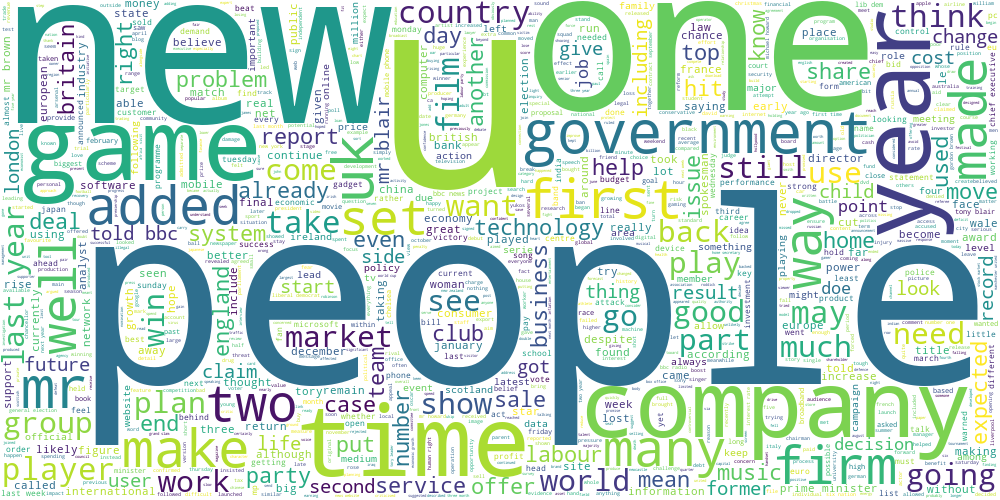

In [22]:
draw_wordcloud(data.text)

**Задание 2.1 (1 балл).** Обучите алгоритм K-Means на tf-idf представлениях текстов. При обучении tf-idf векторайзера рекомендуется отбрасывать редко встречающиеся слова, а также воздержитесь от использования N-грамм. Возьмите не очень большое число кластеров, чтобы было удобно интерпретировать получившиеся темы (например, `n_clusters` = 8). Постройте облака тегов для текстов из разных кластеров. Получились ли темы интерпретируемыми? Попробуйте озаглавить каждую тему.

**Ответ:** Да, более менее получилось. Криво, но что-то похожее на правду в некторых случаях. Можно отделить темы технологии, экономика, кино, Англия, государство, футбол

In [23]:
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.pipeline import Pipeline
import matplotlib.pyplot as plt

In [24]:
kmeans_text = KMeans(n_clusters=8)
vectorizer = TfidfVectorizer()
kmeans_text.fit(vectorizer.fit_transform(data.text))

KMeans()

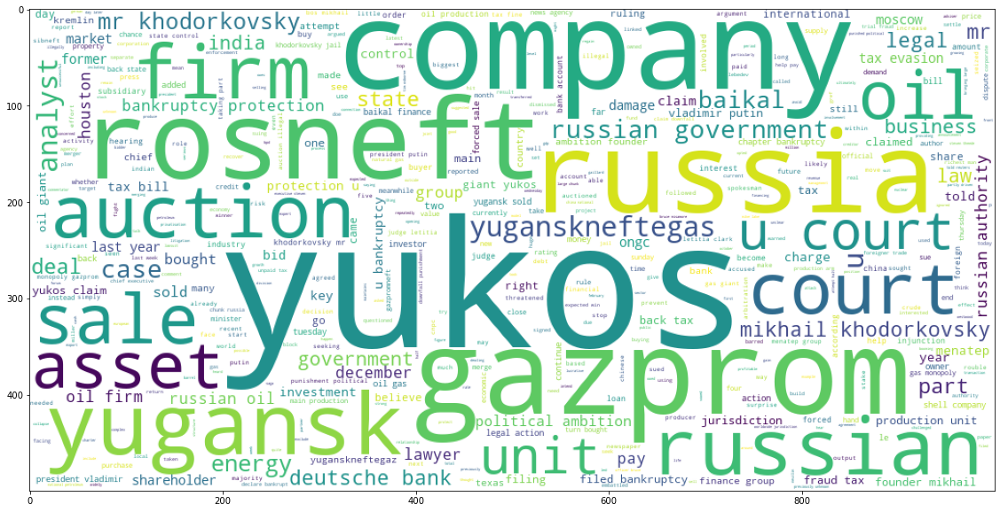

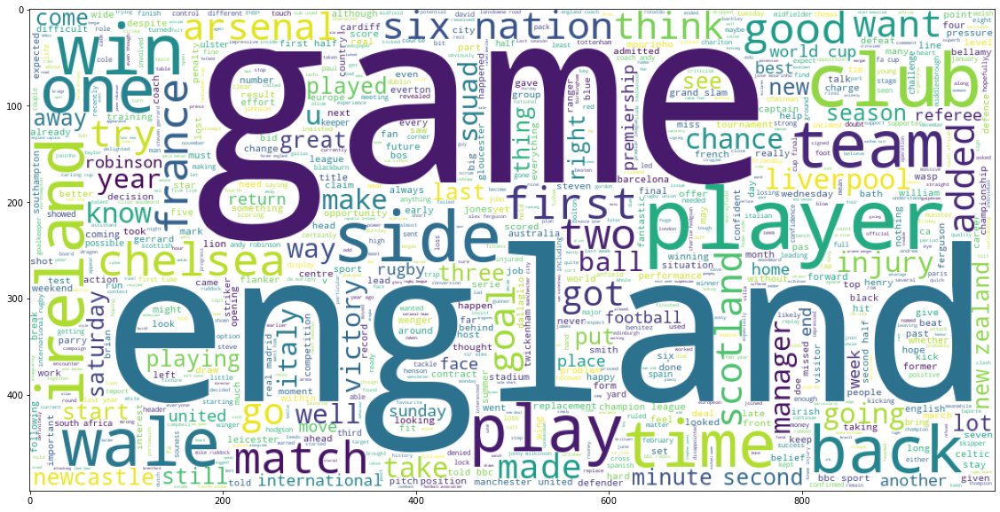

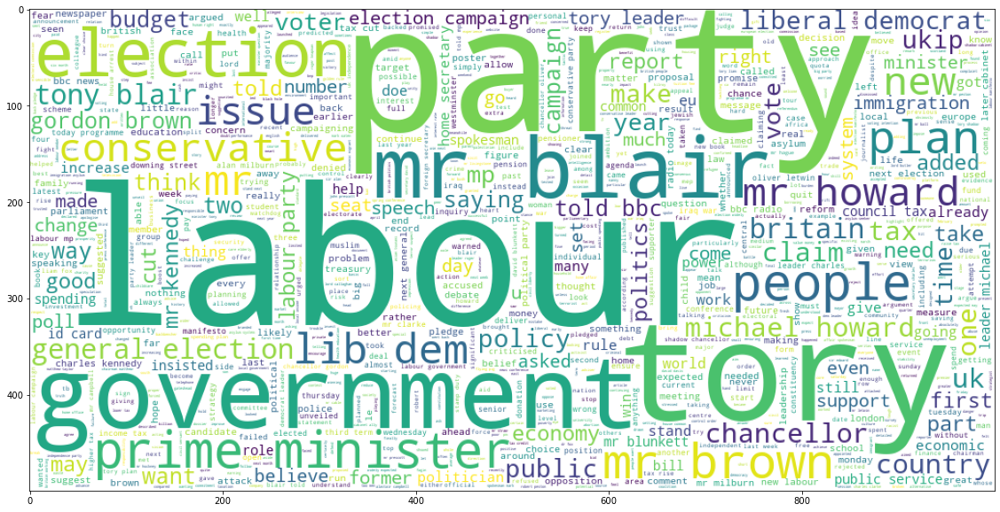

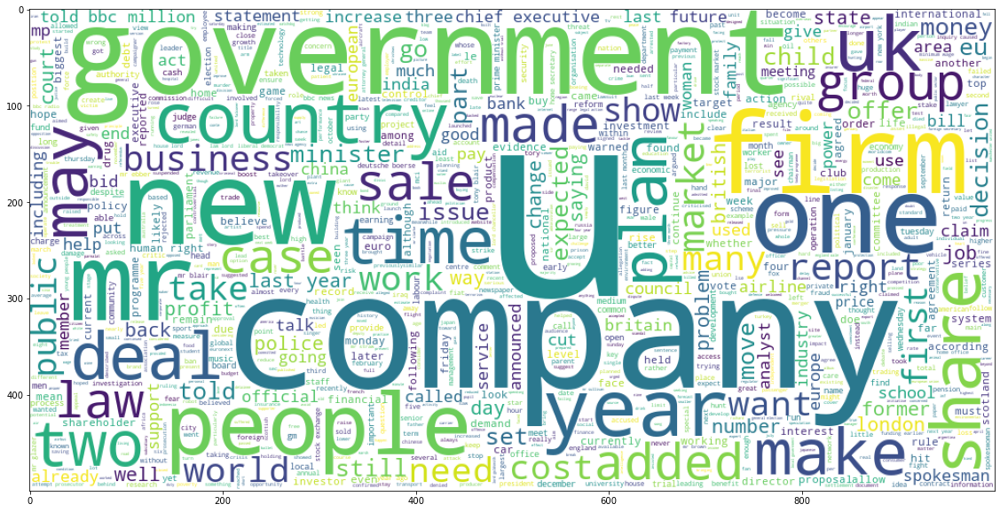

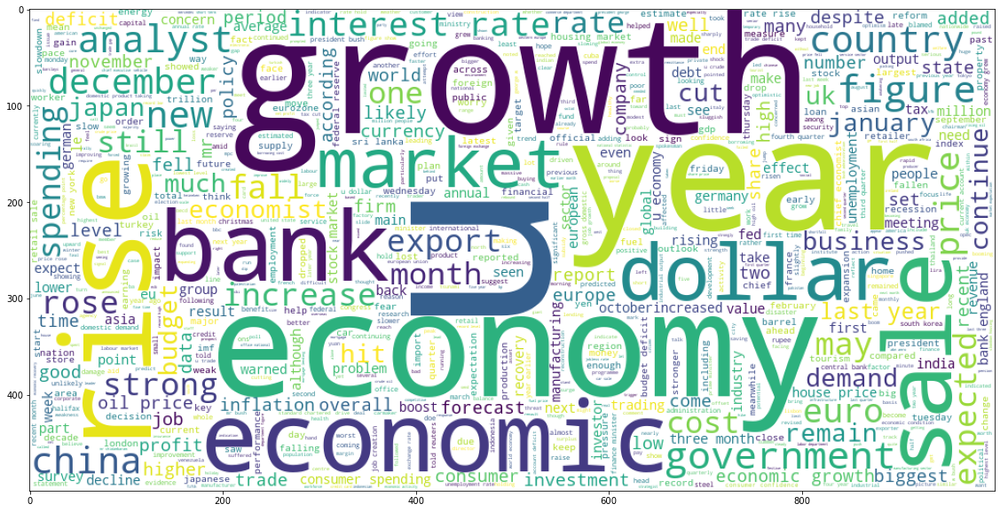

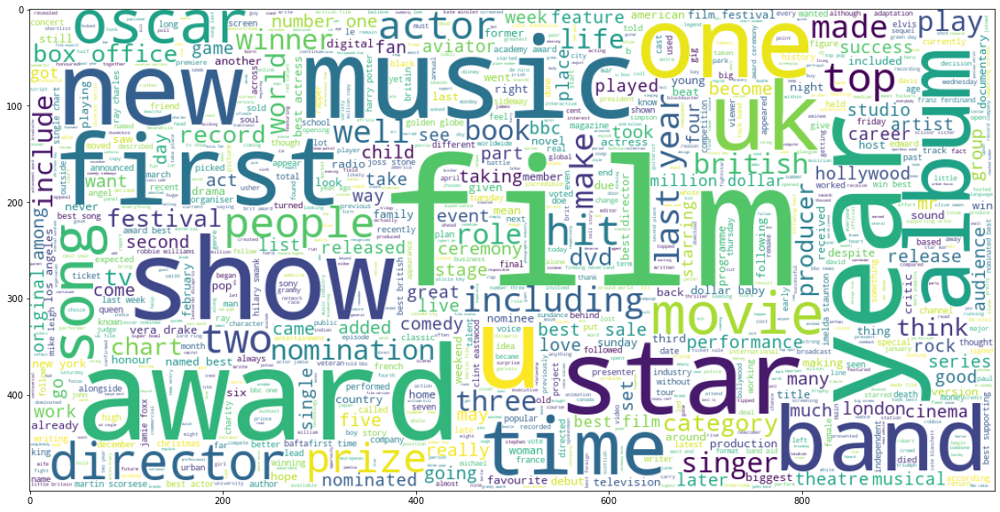

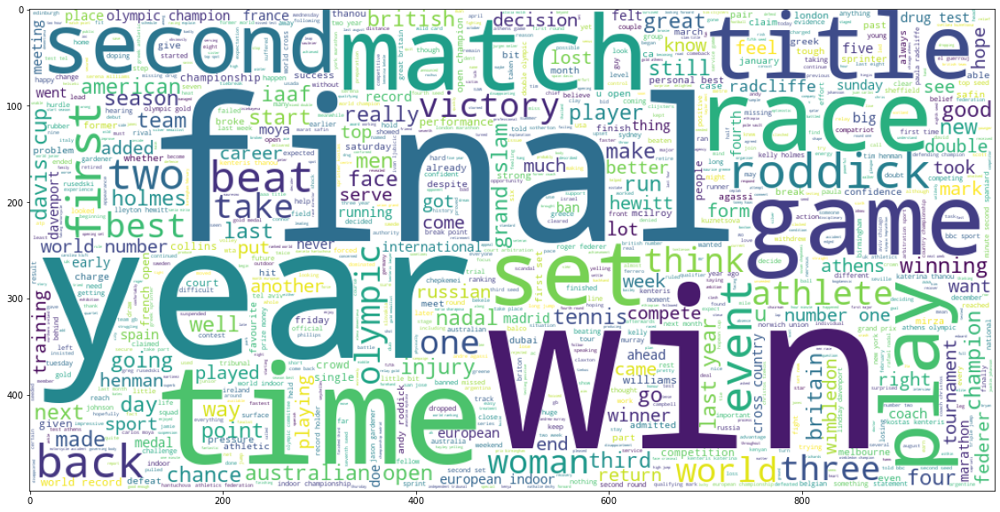

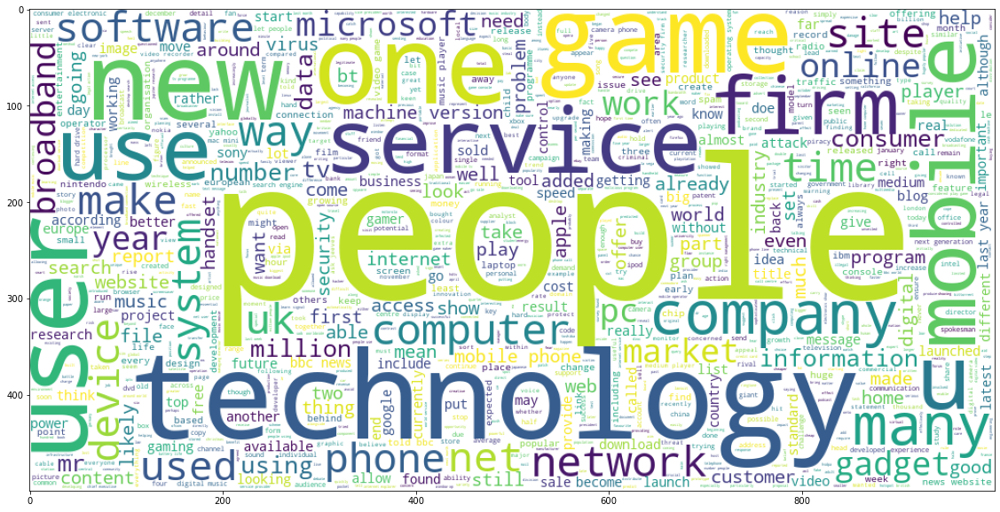

In [25]:
for i in range(8):
    plt.figure(figsize=(20, 10))
    plt.imshow(draw_wordcloud(data[kmeans_text.labels_ == i].text))
    plt.show()

**Задание 2.2 (0.5 балла).** Попробуем другой способ выделить ключевые слова для каждой темы. Помимо непосредственного разбиения объектов алгоритм K-Means получает центр каждого кластера. Попробуйте взять центры кластеров и посмотреть на слова, для которых значения соответствующих им признаков максимальны. Согласуются ли полученные слова с облаками тегов из прошлого задания?

**Ответ:** Получилось красиво, в большистве своем облаков тегов сходится, что впрочем не удивительно

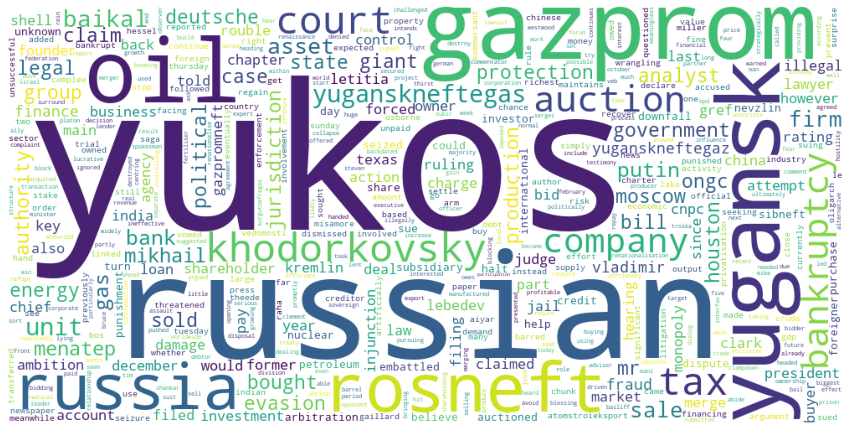

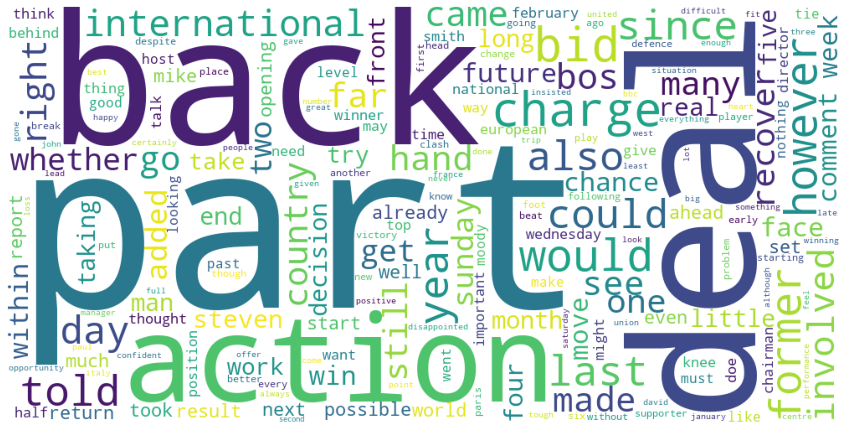

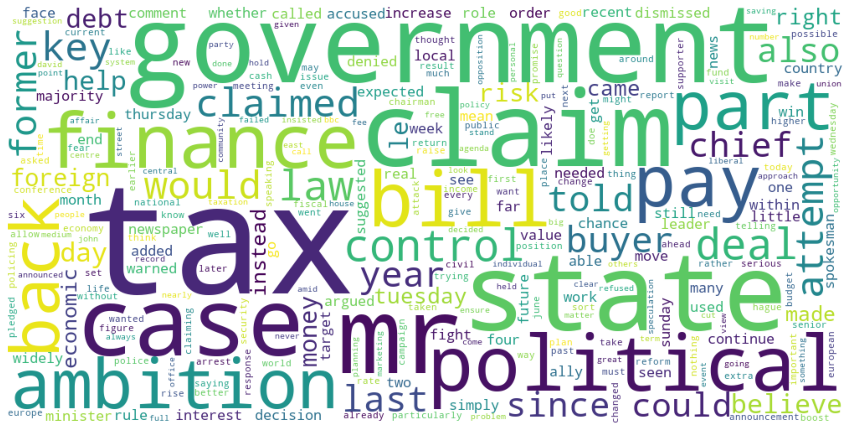

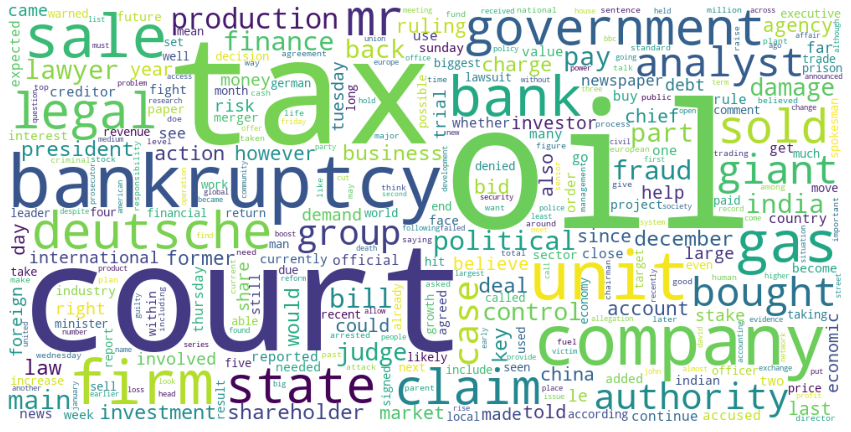

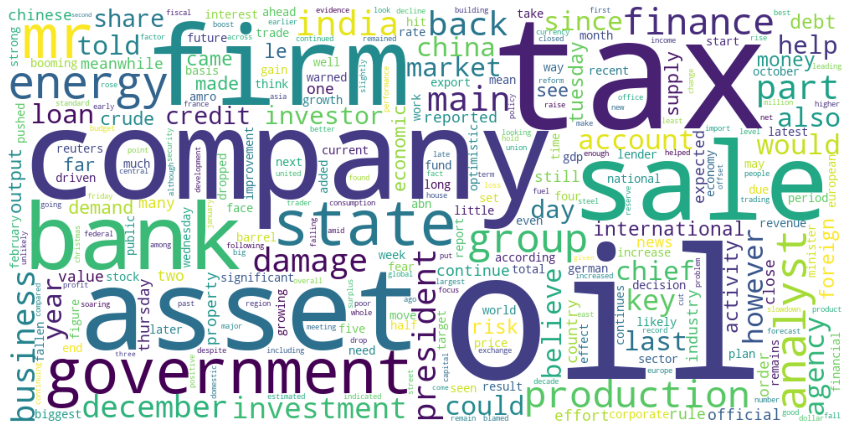

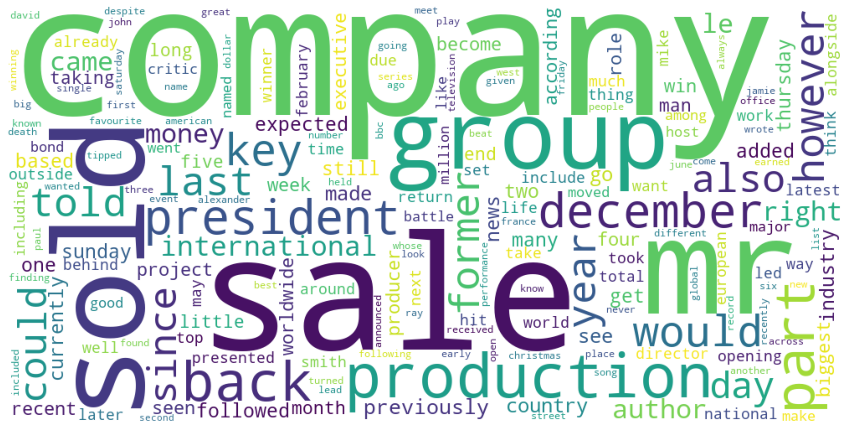

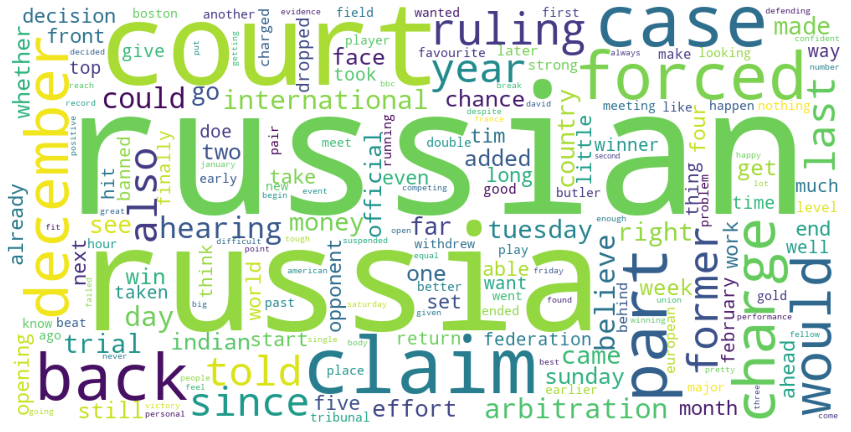

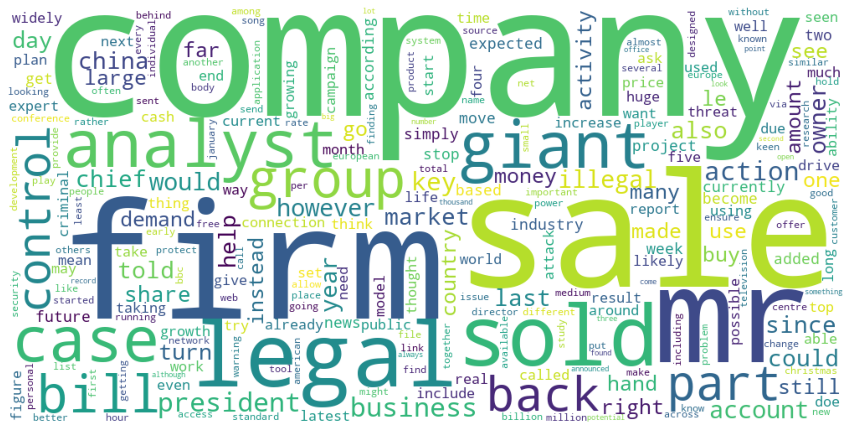

In [26]:
for i in range(8):
    vectorizer.get_feature_names()
    text_ind = kmeans_text.cluster_centers_[i].argsort()[:-500:-1]
    names = np.array(vectorizer.get_feature_names())[text_ind]
    qty = pd.Series(data= kmeans_text.cluster_centers_[0][text_ind], index=names)
    wc = WordCloud(background_color='white', max_words=1000, width=1000, height=500)
    wc.generate_from_frequencies(qty[names].to_dict())
    plt.figure(figsize=(15, 8))
    plt.imshow(wc.to_image())
    plt.axis("off")
    plt.show()

**Задание 2.3 (1.5 балла).** В первой части мы сравнили три разных алгоритма кластеризации на географических данных. Проделаем то же самое для текстовых данных (в качестве признакого описания снова используем tf-idf). Получите три разбиения на кластеры с помощью алгоритмов K-Means, DBSCAN и спектральной кластеризации (на этот раз воспользуйтесь реализацией из `sklearn`). Для K-Means и спектральной кластеризации возьмите одинаковое небольшое число кластеров, подберите параметр `eps` метода DBSCAN так, чтобы получить приблизительно такое же число кластеров.

Далее, обучите двухмерные t-SNE представления над tf-idf признаками текстов. Визуализируйте эти представления для каждого алгоритма, раскрасив каждый кластер своим цветом. Лучше всего расположить визуализации на одном графике на трех разных сабплотах. Не забудьте, что DBSCAN помечает некоторые точки как шумовые (можно раскрасить их в отдельный цвет).

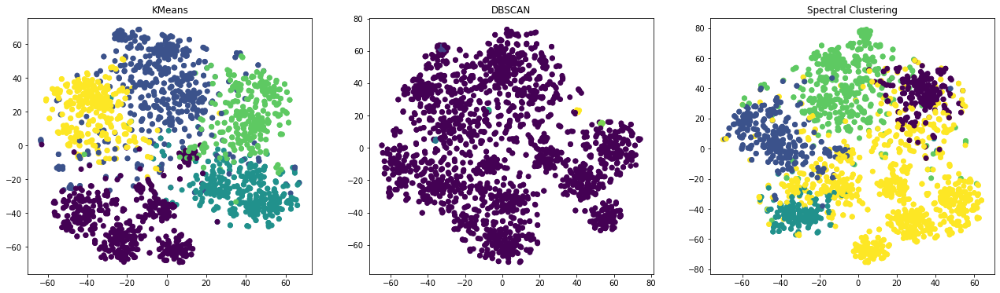

In [27]:
from sklearn.cluster  import SpectralClustering
from sklearn.manifold import TSNE
kmeans = KMeans(n_clusters=5)
dbscan = DBSCAN(eps=0.815)
spectral = SpectralClustering(n_clusters=5)
cls = [kmeans, dbscan, spectral]
names_cls = ['KMeans', 'DBSCAN', 'Spectral Clustering']
data_transformed = TfidfVectorizer(min_df=0.0009, max_df=0.9991).fit_transform(data.text)

plt.figure(figsize=(22, 6))
for i, cl in enumerate(cls):
    ax = plt.subplot(1, 3, i + 1)
    cl.fit(data_transformed)
    data_tsne = TSNE().fit_transform(data_transformed)
    ax.set_title(names_cls[i])
    ax.scatter(data_tsne[:, 0], data_tsne[:, 1], c=cl.labels_)

plt.show()

Прокомментируйте получившиеся результаты. Какой баланс кластеров получился у разных методов? Соотносятся ли визуализации для текстов с визуализациями для географических данных?

**Ответ:** Kmeans получился наиболее сбалансированым, хуже всех отработал DBSCAN, вообще оказался как-то бесполезен. Спектральная кластеризация показалась наиболее приближенной к жизни. 

**Задание 2.4 (1.5 балла).** Обучите модель латентного размещения Дирихле. Не забудьте, что она работает с мешком слов, а не с tf-idf признаками. Придумайте, как превратить распределение тем для текста в номер его кластера. Возьмите параметр `n_components` в 2-3 раза больше, чем число кластеров для K-Means. Получились ли темы более узкими от такого нововведения? Постройте облака тегов для нескольких наиболее удачных тем.

**Ответ:** Нет темы не получились более узкими, они сильно похоже друг на друга, но главные отделились, что не может не радовать

In [28]:
from sklearn.decomposition import LatentDirichletAllocation
from sklearn.feature_extraction.text import CountVectorizer
direchle = LatentDirichletAllocation(n_components=15)
vectorizer = CountVectorizer() 
direchle = direchle.fit_transform(vectorizer.fit_transform(data.text))

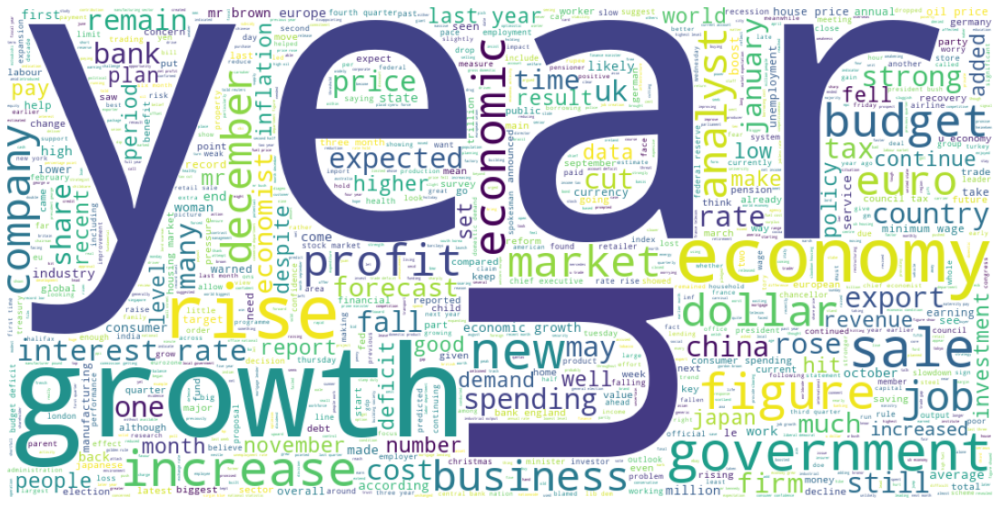

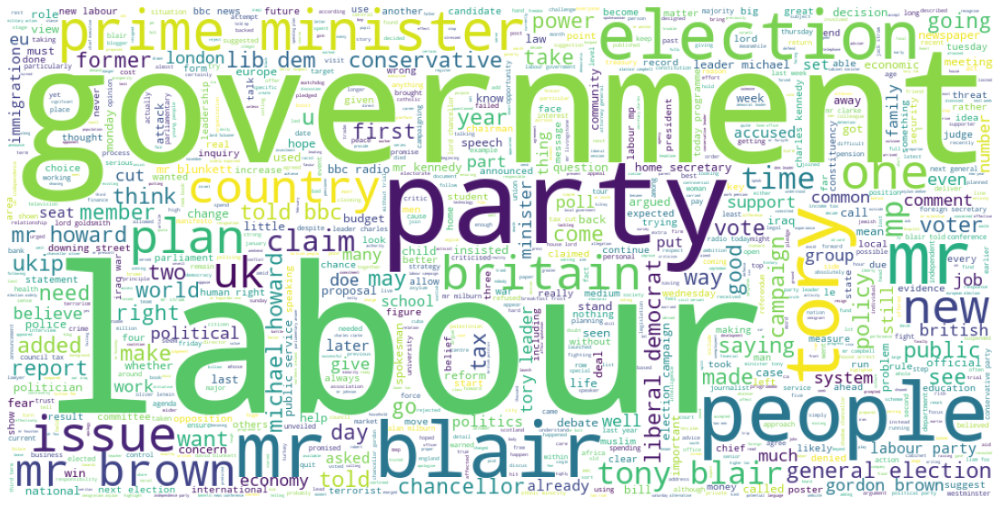

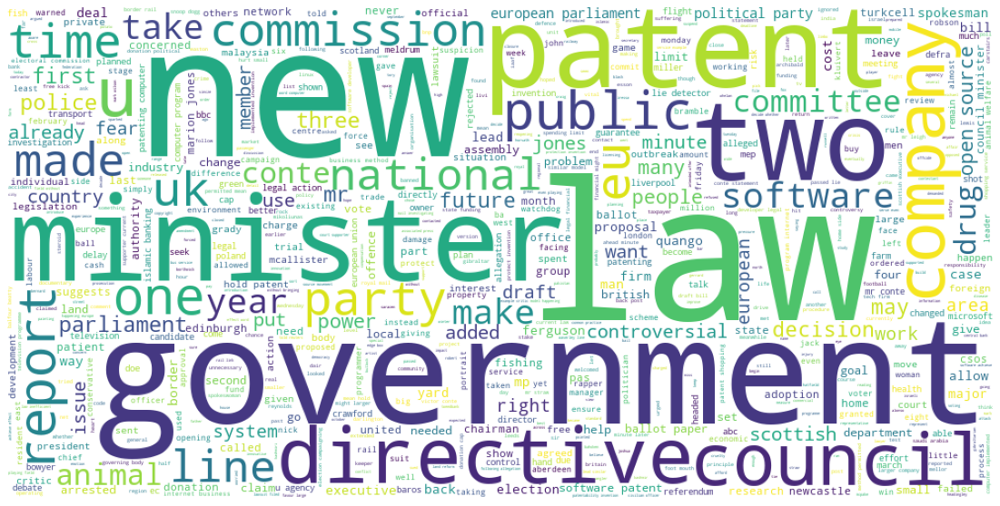

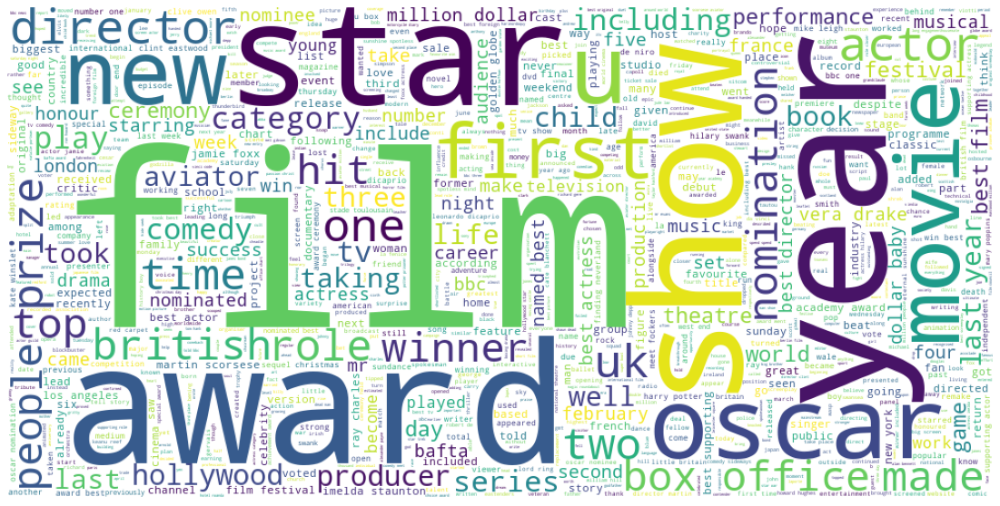

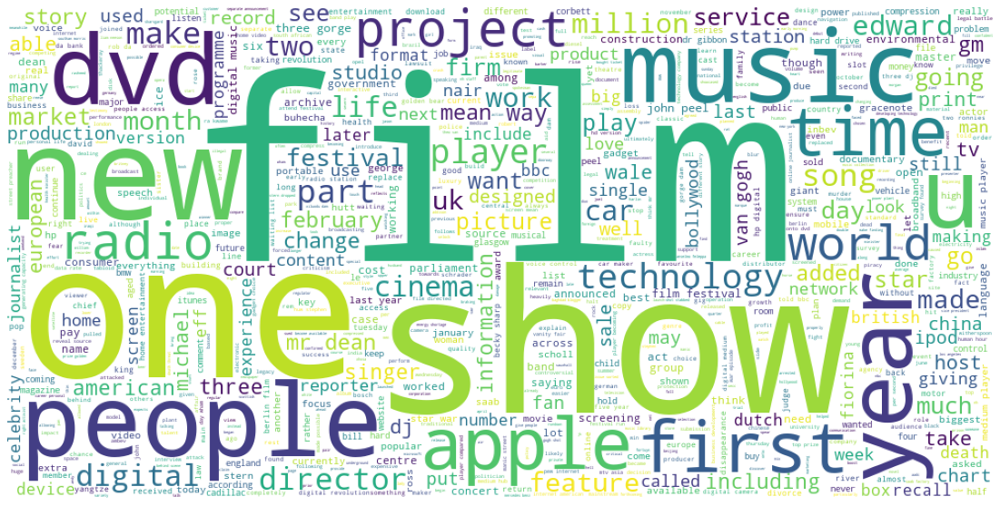

...

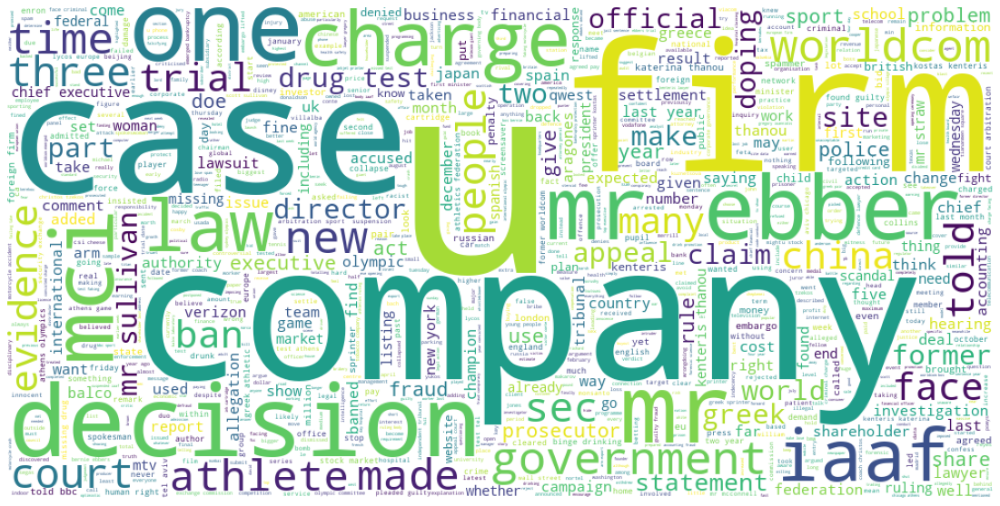

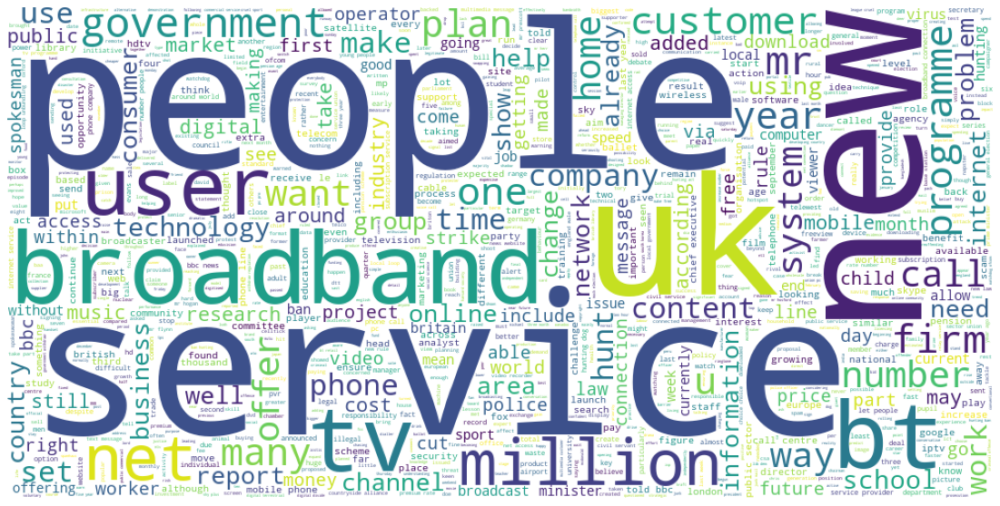

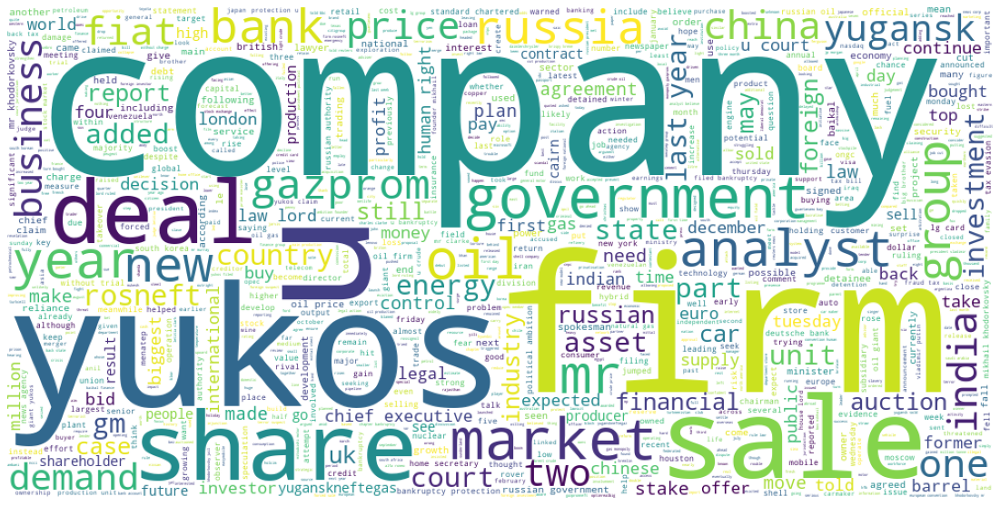

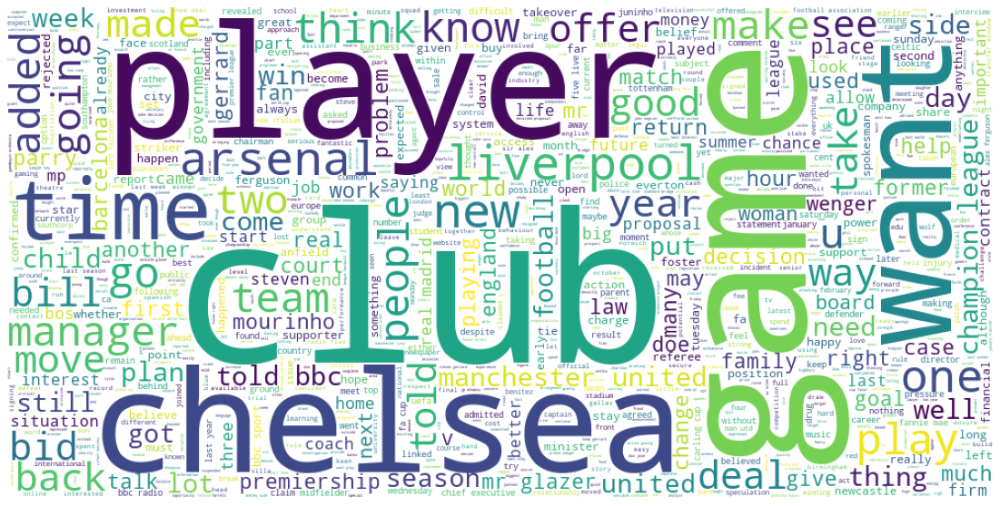

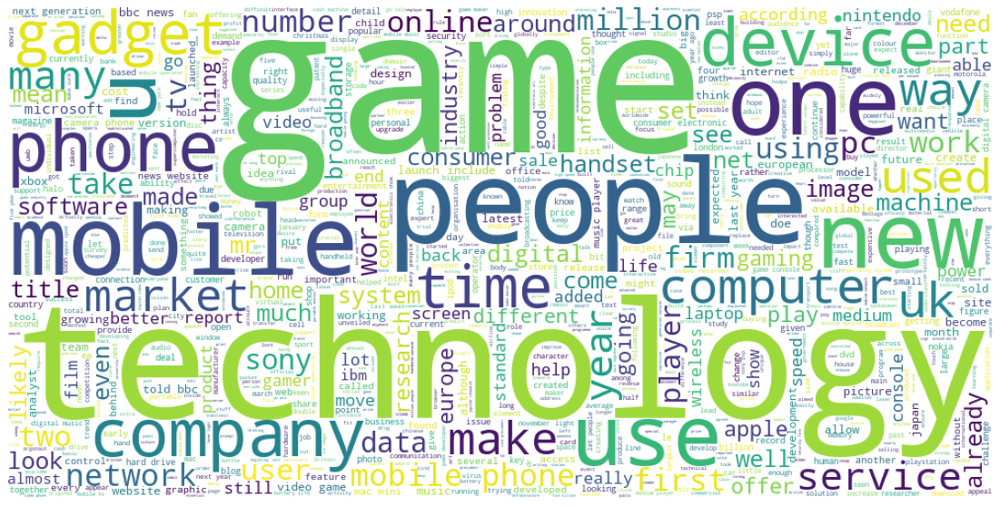

In [29]:
for i in range(15):
    plt.figure(figsize=(20, 10))
    plt.imshow(draw_wordcloud(data[np.argmax(direchle, 1) == i].text))
    plt.axis('off')
    plt.show()

## Часть 3. Transfer learning для задачи классификации текстов

**Задание 3.1 (0.5 балла).** Вспомним, что у нас есть разметка для тематик статей. Попробуем обучить классификатор поверх unsupervised-представлений для текстов. Рассмотрите три модели:

* Логистическая регрессия на tf-idf признаках
* K-Means на tf-idf признаках + логистическая регрессия на расстояниях до центров кластеров
* Латентное размещение Дирихле + логистическая регрессия на вероятностях тем

Разделите выборку на обучающую и тестовую, замерьте accuracy на обоих выборках для всех трех моделей. Параметры всех моделей возьмите равными значениям по умолчанию.

In [30]:
import random

random.seed(55)

In [31]:
from sklearn.pipeline import Pipeline
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score
X_train, X_test, y_train, y_test = train_test_split(data.text, data.category, train_size=0.8)

pipe_logit = Pipeline([
    ('tf-idf', TfidfVectorizer(min_df=0.0009, max_df=0.9991)),
    ('log-reg', LogisticRegression())
])

pipe_kmeans = Pipeline([
    ('tf-idf', TfidfVectorizer(min_df=0.0009, max_df=0.9991)),
    ('kmeans', KMeans(n_clusters=100)),
    ('log-reg', LogisticRegression(max_iter=30000))
])

pipe_dir = Pipeline([
    ('tf-idf', TfidfVectorizer(min_df=0.0009, max_df=0.9991)),
    ('dir', LatentDirichletAllocation(n_components=500)),
    ('log-reg', LogisticRegression())
])
pipes = [pipe_logit, pipe_dir, pipe_kmeans]

names = ['Логистическая регрессия на tf-idf признаках', 
         'K-Means на tf-idf признаках + логистическая регрессия на расстояниях до центров кластеров',
         'Латентное размещение Дирихле + логистическая регрессия на вероятностях тем']

table = []
for i, pipe in enumerate(pipes):
    pipe.fit(X_train, y_train)
    table.append((names[i], accuracy_score(y_train, pipe.predict(X_train)), 
                  accuracy_score(y_test, pipe.predict(X_test))))

In [32]:
from tabulate import tabulate
print(tabulate(table, headers=['Название модели', 'Train', 'Test'], tablefmt='grid'))

+-------------------------------------------------------------------------------------------+----------+----------+
| Название модели                                                                           |    Train |     Test |
+===========================================================================================+==========+==========+
| Логистическая регрессия на tf-idf признаках                                               | 0.996067 | 0.982022 |
+-------------------------------------------------------------------------------------------+----------+----------+
| K-Means на tf-idf признаках + логистическая регрессия на расстояниях до центров кластеров | 0.871348 | 0.853933 |
+-------------------------------------------------------------------------------------------+----------+----------+
| Латентное размещение Дирихле + логистическая регрессия на вероятностях тем                | 0.957865 | 0.957303 |
+-----------------------------------------------------------------------

У какой модели получилось лучшее качество? С чем это связано?

**Ответ:** На тесте отработала самая простая модель лучше всех :). СИЛА В ПРОСТОТЕ. Возможно на kmeans - происходит переобучение и нужно подобрать гиперпараметры, третья модель отработала достаточно хорошо.

**Задание 3.2 (1.5 балла).** Теперь просимулируем ситуацию слабой разметки, которая часто встречается в реальных данных. Разделим обучающую выборку в пропорции 5:65:30. Будем называть части, соответственно, размеченный трейн, неразмеченный трейн и валидация.

Все unsupervised-алгоритмы (векторайзеры и алгоритмы кластеризации) запускайте на всем трейне целиком (размеченном и неразмеченном, суммарно 70%), а итоговый классификатор обучайте только на размеченном трейне (5%). Подберите гиперпараметры моделей по качеству на валидации (30%), а затем оцените качество на тестовой выборке (которая осталась от прошлого задания). Не скромничайте при подборе числа кластеров, сейчас нас интересует не интерпретируемое разбиение выборки, а итоговое качество классификации. 

In [33]:
vectorizer_tf_idf = TfidfVectorizer()
vectorizer_bag = CountVectorizer()
X_train, X_valid, y_train, y_valid = train_test_split(X_train, y_train, test_size=0.3, random_state=55)
vectorizer_tf_idf.fit(X_train, y_train)
vectorizer_bag.fit(X_train)
kmeans_ = KMeans(n_clusters=15)
kmeans_.fit(vectorizer_tf_idf.transform(X_train))
direchle = LatentDirichletAllocation(n_components=50)
direchle = direchle.fit(vectorizer_bag.transform(X_train))
X_train, X_unsupervised, y_train, y_unsupervised = train_test_split(X_train, y_train,
                                                                    train_size=5/70, random_state=55)

In [34]:
Cs= np.logspace(-2, 5, 50)
best_valid_score1, best_valid_score2, best_valid_score3 = -1, -1, -1
best_c1, best_c2, best_c3 = 1, 1, 1

table = []
for c in Cs:
    LR1 = LogisticRegression('l2', C=c).fit(vectorizer_tf_idf.transform(X_train), y_train)
    LR2 = LogisticRegression('l2', C=c, max_iter=30000).fit(kmeans_.transform(
        vectorizer_tf_idf.transform(X_train)), y_train)
    LR3 = LogisticRegression('l2', C=c, max_iter=30000).fit(direchle.transform(
        vectorizer_bag.transform(X_train)), y_train)
    valid_score1 = accuracy_score(y_valid, LR1.predict(vectorizer_tf_idf.transform(X_valid)))
    valid_score2 = accuracy_score(y_valid, LR2.predict(kmeans_.transform(vectorizer_tf_idf.transform(X_valid))))
    valid_score3 = accuracy_score(y_valid, LR3.predict(direchle.transform(vectorizer_bag.transform(X_valid))))
    if valid_score1 > best_valid_score1:
        best_c1 = c
        best_valid_score1 = valid_score1
    if valid_score2 > best_valid_score2:
        best_c2 = c
        best_valid_score2 = valid_score2
    if valid_score3 > best_valid_score3:
        best_c3 = c
        best_valid_score3 = valid_score3        

In [35]:
LR1 = LogisticRegression('l2', C=best_c1).fit(vectorizer_tf_idf.transform(X_train), y_train)
LR2 = LogisticRegression('l2', C=best_c2, max_iter=30000).fit(kmeans_.transform(
        vectorizer_tf_idf.transform(X_train)), y_train)
LR3 = LogisticRegression('l2', C=best_c3, max_iter=30000).fit(direchle.transform(
    vectorizer_bag.transform(X_train)), y_train)
train_score1 = accuracy_score(y_train, LR1.predict(vectorizer_tf_idf.transform(X_train)))
train_score2 = accuracy_score(y_train, LR2.predict(kmeans_.transform(vectorizer_tf_idf.transform(X_train))))
train_score3 = accuracy_score(y_train, LR3.predict(direchle.transform(vectorizer_bag.transform(X_train))))
test_score1 = accuracy_score(y_test, LR1.predict(vectorizer_tf_idf.transform(X_test)))
test_score2 = accuracy_score(y_test, LR2.predict(kmeans_.transform(vectorizer_tf_idf.transform(X_test))))
test_score3 = accuracy_score(y_test, LR3.predict(direchle.transform(vectorizer_bag.transform(X_test))))

In [36]:
print(tabulate([
    (names[0], round(train_score1, 3), round(test_score1, 3), round(best_valid_score1, 3)),
    (names[1], round(train_score2, 3), round(test_score2, 3), round(best_valid_score2, 3)),
    (names[2], round(train_score3, 3), round(test_score3, 3), round(best_valid_score3, 3))
], headers=['Название модели', 'Train', 'Test', 'valid'], tablefmt='simple'
))

Название модели                                                                              Train    Test    valid
-----------------------------------------------------------------------------------------  -------  ------  -------
Логистическая регрессия на tf-idf признаках                                                  1       0.892    0.908
K-Means на tf-idf признаках + логистическая регрессия на расстояниях до центров кластеров    0.989   0.924    0.925
Латентное размещение Дирихле + логистическая регрессия на вероятностях тем                   0.989   0.894    0.912


Как изменились результаты по сравнению с обучением на полной разметке? Сделайте выводы.

**Ответ:** Качество во второй модели сильно улучшилось, подбор гиперпараметров прошел успшено, а с первой и второй моделью как-то не очень. В первой модели мы перестарались, с третью моделью как-то тоже не очень получилось.

## Бонус

**Задание 4 (1 балл)**. Разберитесь с semi-supervised методами, которые реализованы в `sklearn` и примените их к заданию 3.2. Получилось ли добиться лучшего качества? Сделайте выводы.

**Задание 5 (1 балл)**. На занятиях мы обсуждали, что метрика [BCubed](https://www.researchgate.net/profile/Julio-Gonzalo-2/publication/225548032_Amigo_E_Gonzalo_J_Artiles_J_et_alA_comparison_of_extrinsic_clustering_evaluation_metrics_based_on_formal_constraints_Inform_Retriev_12461-486/links/0c96052138dbb99740000000/Amigo-E-Gonzalo-J-Artiles-J-et-alA-comparison-of-extrinsic-clustering-evaluation-metrics-based-on-formal-constraints-Inform-Retriev-12461-486.pdf) хорошо подходит для сравнения алгоритмов кластеризации, если нам известно настоящее разделение на кластеры (gold standard). Реализуйте подсчет метрики BCubed и сравните несколько алгоритмов кластеризации на текстовых данных из основного задания. В качестве gold standard используйте разметку category.

In [37]:
# YOUR CODE HERE ‿︵‿︵ヽ(°□° )ノ︵‿︵‿

**Задание 6 (2 баллa)**. Спектральная кластеризация, по сути, является обычной кластеризацией KMeans поверх эмбеддингов объектов, которые получаются из лапласиана графа. А что, если мы попробуем построить эмбеддинги каким-нибудь другим способом? В этом задании мы предлагаем вам проявить немного фантазии. Возьмите какие-нибудь данные высокой размерности, чтобы задача обучения эмбеддингов имела смысл (например, картинки или тексты, желательно выбрать что-нибудь оригинальное). Придумайте или найдите какой-нибудь метод обучения эмбеддингов, примените его к данным и кластеризуйте полученные представления. Если чувствуете в себе достаточно силы, можете попробовать что-нибудь нейросетевое. Сравните ваш подход с базовыми алгоритмами кластеризации, которое мы рассмотрели в основном задании, не забывайте про визуализации! Ключевые слова для вдохновения: ***KernelPCA***, ***UMAP***, ***autoencoders***, ***gensim***. 

In [38]:
# YOUR CODE HERE ‿︵‿︵ヽ(°□° )ノ︵‿︵‿

**Задание 7 (1e-100 балла)**. Опишите свои ощущения от этой домашки, поощряется сравнение с предыдущей.

In [39]:
# YOUR CODE HERE (ノಠ益ಠ)ノ彡┻━┻